In [1]:
import os
from pathlib import Path

import torch
import torch.nn as nn
from matplotlib import pyplot as plt
from torch import Tensor
from torchvision.utils import make_grid

In [2]:
from zprp.models.cycle_gan.data import CycleGanDataModule
from zprp.models.cycle_gan.model import CycleGAN

Setup common data paths:

In [3]:
REPO_PATH = Path("../" if Path(os.getcwd()).name == "notebooks" else ".")
DATA_PATH = REPO_PATH / "data"
CONTENT_PATH = DATA_PATH / "photo/0"
STYLE_PATH = DATA_PATH / "monet/0"

MODELS_PATH = REPO_PATH / "models"

In [4]:
device = torch.device("cuda") if torch.cuda.is_available else torch.device("cpu")

In [5]:
def unnormalize(x: torch.Tensor) -> torch.Tensor:
    return (x * 0.5) + 0.5

## L1 vs L2 experiment

In [6]:
class L2CycleConsistencyLoss(nn.Module):
    """L2 norm"""

    @staticmethod
    def forward(real: Tensor, reconstructed: Tensor) -> Tensor:
        return torch.sqrt(torch.mean(torch.pow(real - reconstructed, 2)))

In [7]:
l1_log_dir = MODELS_PATH / "lambdas/lightning_logs"
l2_log_dir = MODELS_PATH / "l2/lightning_logs"

In [8]:
lambdas = [1, 2, 5, 10, 20]
epochs = 30

In [9]:
dm = CycleGanDataModule(
    content_path=CONTENT_PATH, style_path=STYLE_PATH, n_val_images=64, batch_size=16, img_size=256, random_seed=834
)
dm.setup("fit")

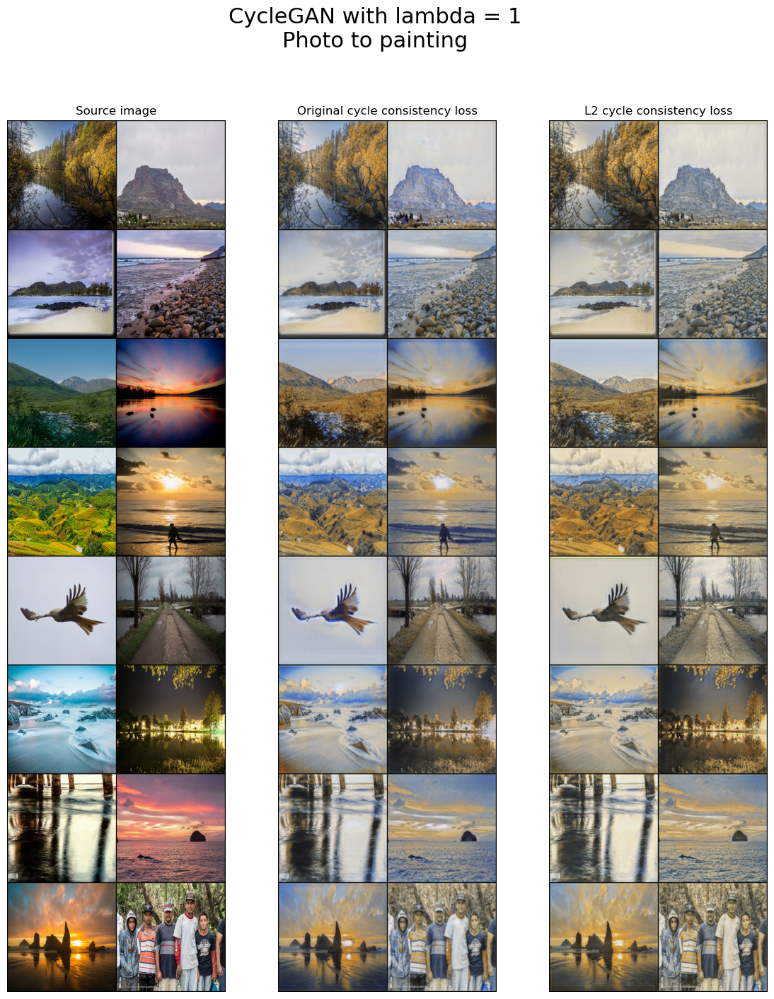

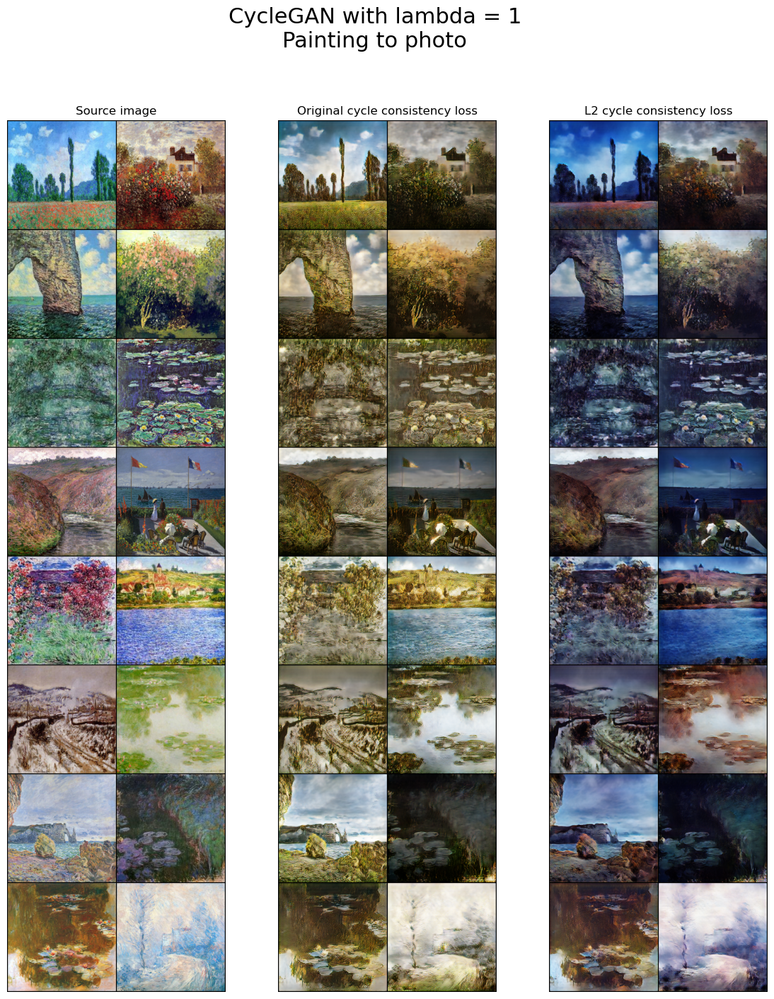

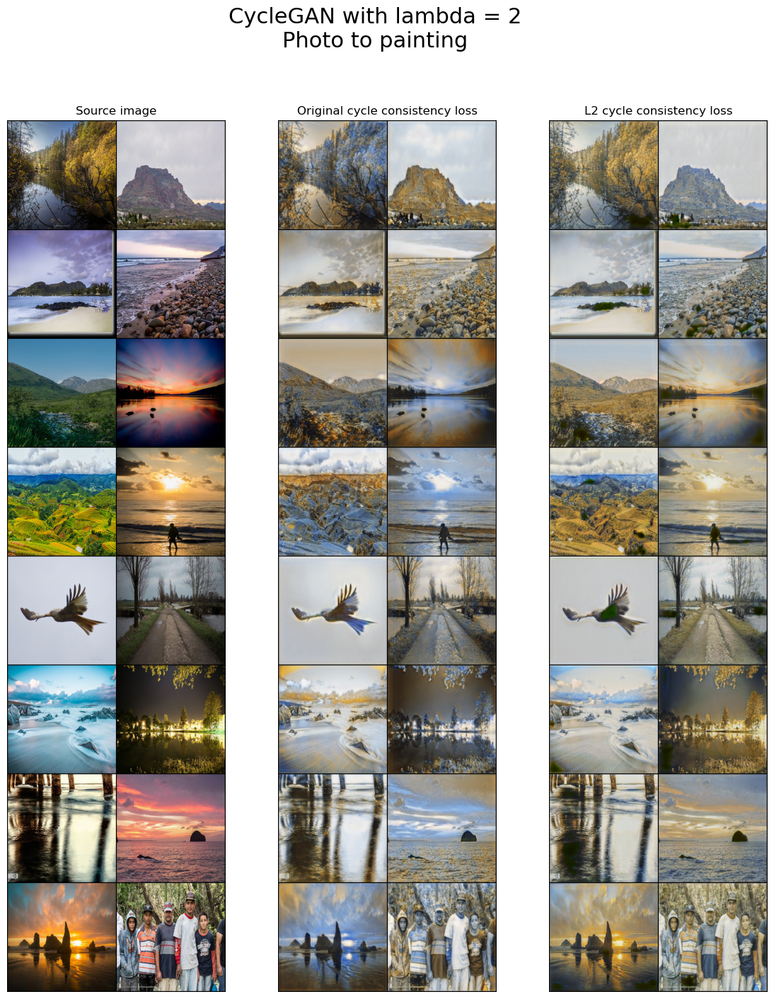

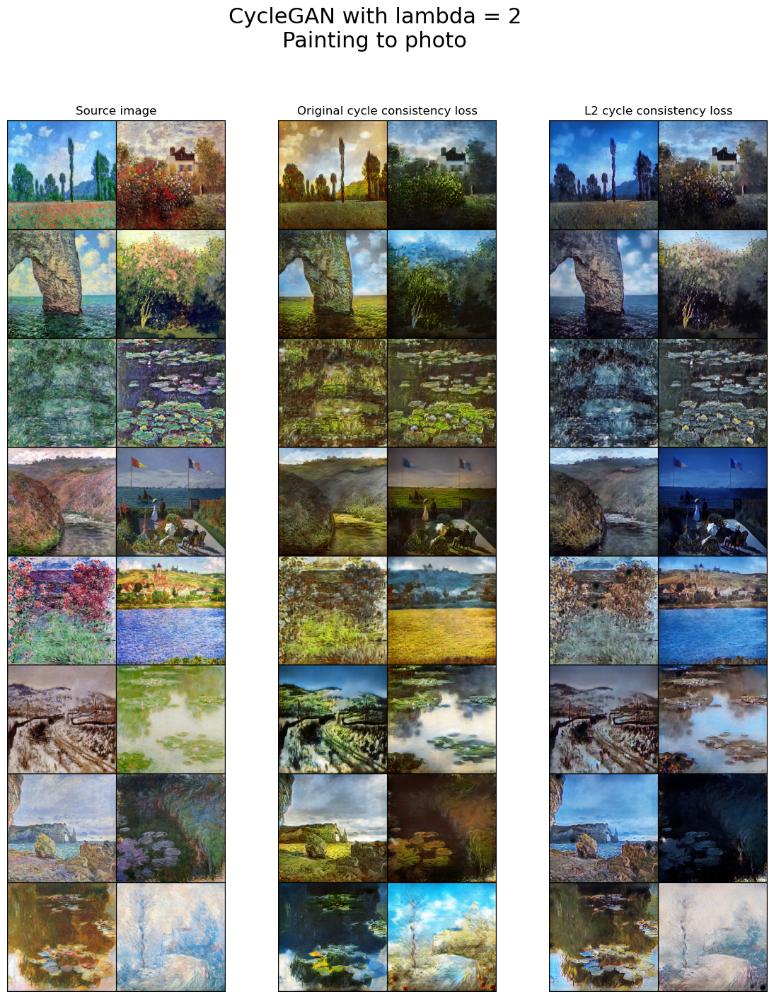

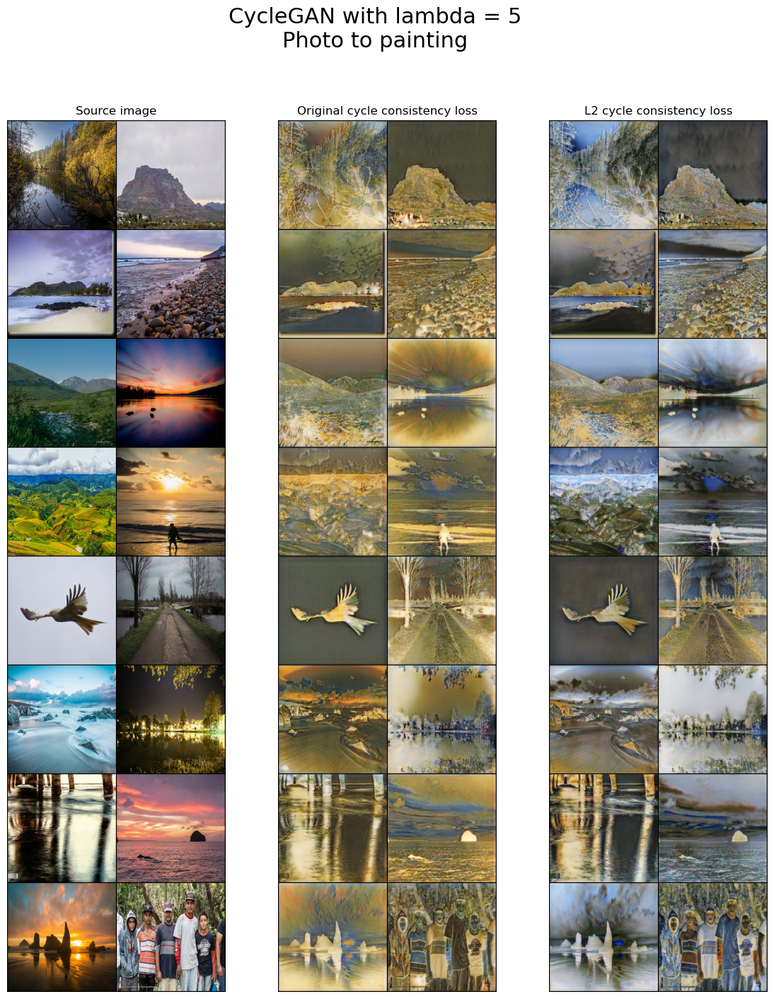

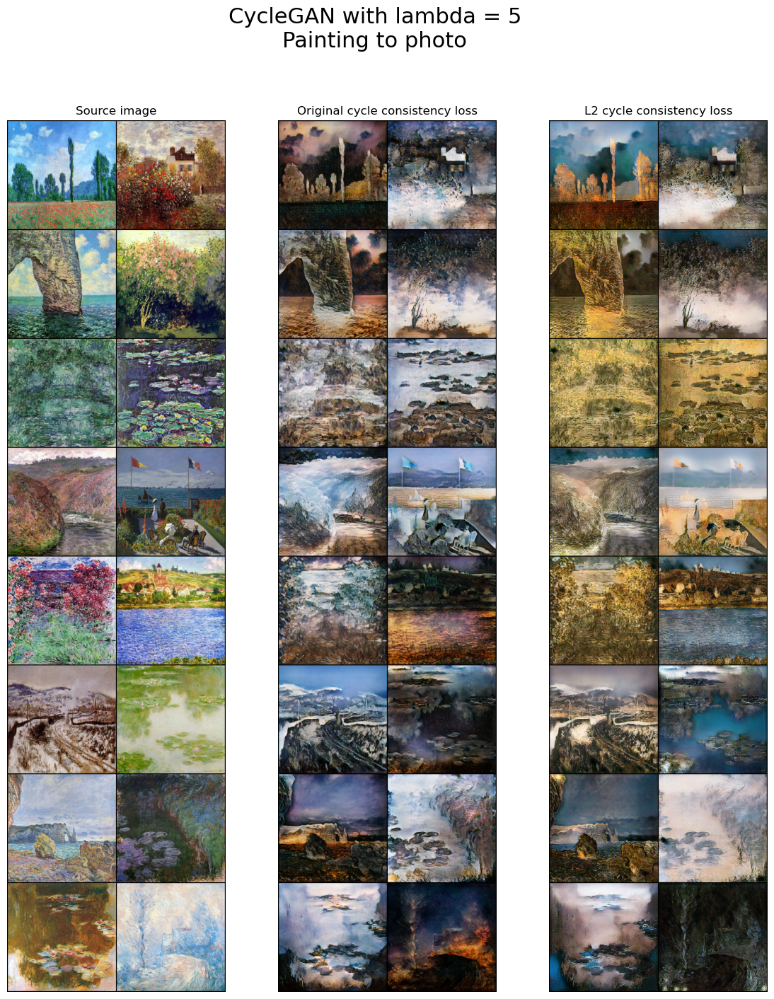

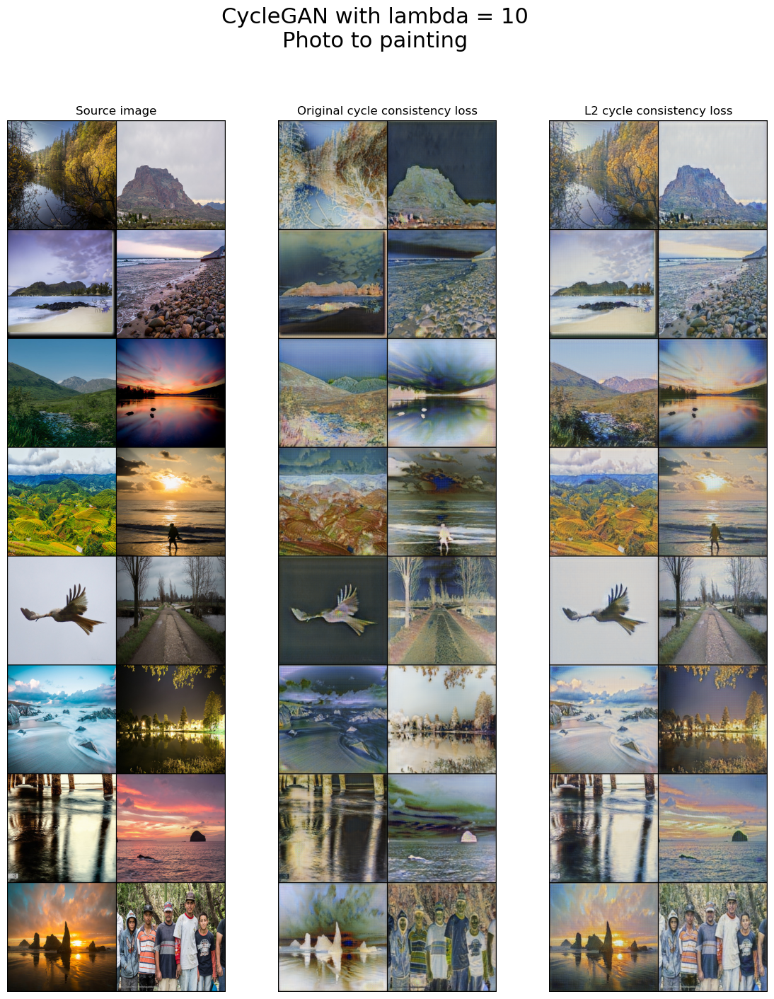

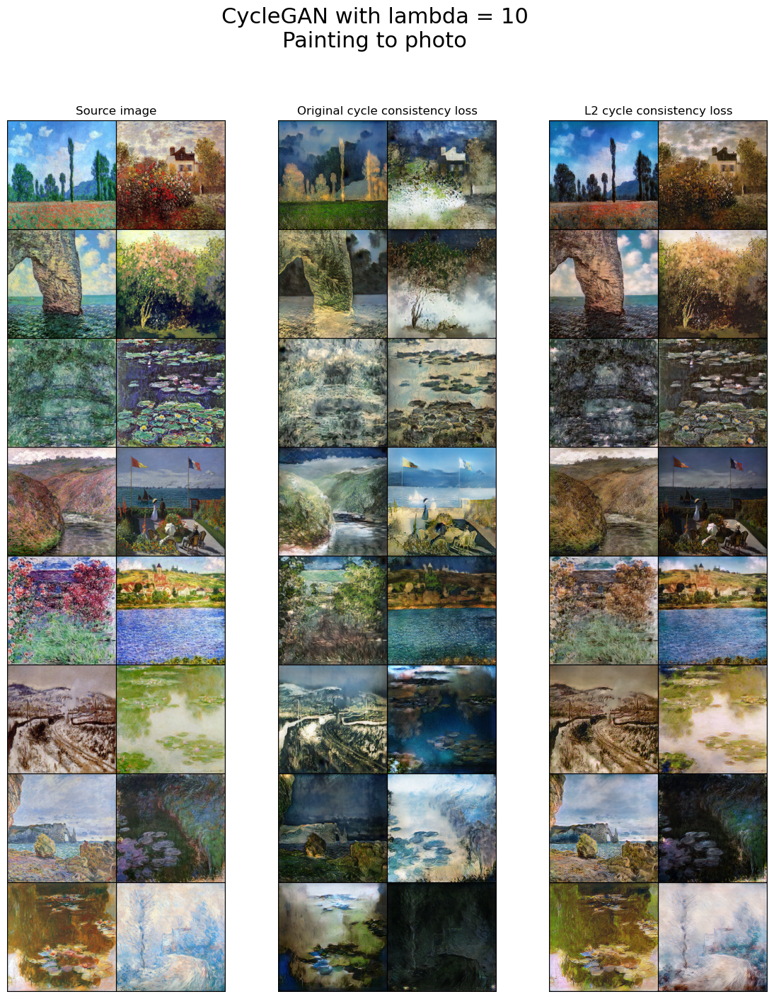

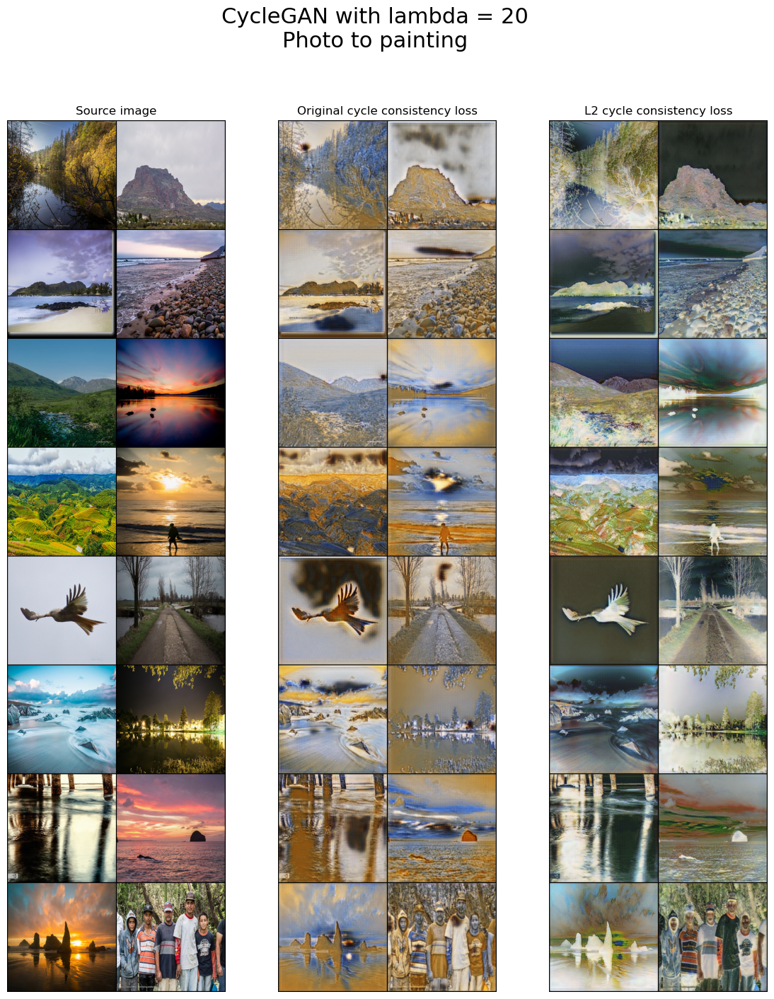

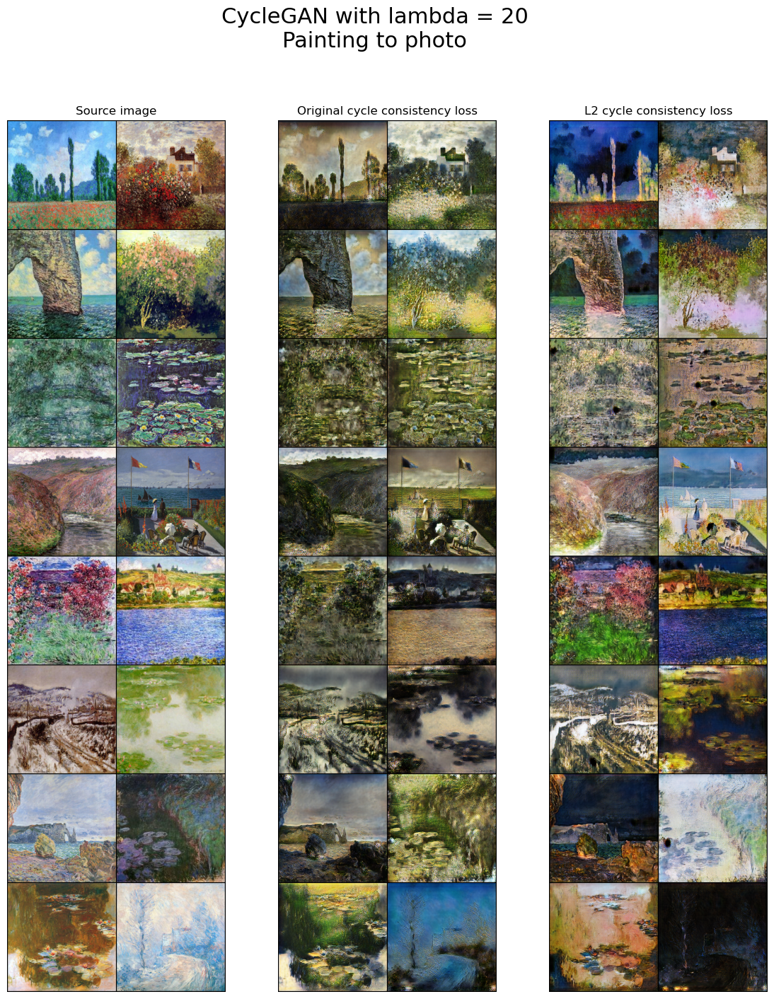

In [10]:
plt.rcParams["figure.figsize"] = (14, 16)


def compare_l1_l2(
    l1_checkpoint: Path,
    l2_checkpoint: Path,
    images_x: Tensor,
    images_y: Tensor,
    title: str,
):
    for images, transfer_fun, plot_name in [
        (images_x, CycleGAN.x_to_y, "Photo to painting"),
        (images_y, CycleGAN.y_to_x, "Painting to photo"),
    ]:
        fig, axes = plt.subplots(1, 3)

        axes[0].imshow(make_grid(unnormalize(images), nrow=2).permute(1, 2, 0))
        axes[0].set_title("Source image")
        axes[0].axis("off")

        for checkpoint, subplot_name, ax in zip(
            [l1_checkpoint, l2_checkpoint],
            ["Original cycle consistency loss", "L2 cycle consistency loss"],
            axes[1:],
        ):
            model = CycleGAN.load_from_checkpoint(checkpoint).to(device)
            model.eval()
            model.g.eval()
            model.f.eval()
            with torch.no_grad():
                ax.imshow(
                    make_grid(unnormalize(transfer_fun(model, (images.to(device)))), nrow=2).permute(1, 2, 0).cpu()
                )
                ax.set_title(subplot_name)
                ax.axis("off")

        fig.suptitle(f"{title}\n{plot_name}", size=22)

        plt.show()


for lambda_value in lambdas:
    images_x, images_y = next(iter(dm.val_dataloader()))
    images_x, images_y = images_x[:16], images_y[:16]

    l1_checkpoint = (
        next(iter((l1_log_dir / f"cyclegan_lambdas_experiment_l{lambda_value}").iterdir()))
        / "checkpoints/checkpoint_periodic-epoch=0029.ckpt"
    )
    l2_checkpoint = (
        next(iter((l2_log_dir / f"cyclegan_l2_experiment_l{lambda_value}").iterdir()))
        / "checkpoints/checkpoint_periodic-epoch=0029.ckpt"
    )
    compare_l1_l2(
        l1_checkpoint=l1_checkpoint,
        l2_checkpoint=l2_checkpoint,
        images_x=images_x,
        images_y=images_y,
        title=f"CycleGAN with lambda = {lambda_value}",
    )